In [1]:
import os
import numpy as np
from pycocotools.coco import COCO
from mmcv import Config
import mmdet.apis as mmapi
from mmdet.datasets import build_dataset
import matplotlib.pyplot as plt
from PIL import Image
from mmdet.models import MaskRCNN
import cv2

D:\University\miniconda3\envs\RoadDamageDetection\lib\site-packages\mmcv\__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(


In [6]:
DATASET_DIR = './DatasetCocoFormat1200/'
TRAIN_DIR = DATASET_DIR + 'train/'
TEST_DIR  = DATASET_DIR + 'test/'
VAL_DIR = DATASET_DIR + 'val/'
ANN_DIR = DATASET_DIR + 'annotations/'
TRAIN_ANN_PTH = ANN_DIR + "train.json"
VAL_ANN_PTH = ANN_DIR + "val.json"
TEST_ANN_PTH = ANN_DIR + "test.json"
CONFIGS_DIR = "./configs/"
MRCNN_USER_CONFIG_PTH = CONFIGS_DIR + "mask_rcnn_r50_fpn_1x_coco_for_road_damages_3.py"
MRCNN_RESNET50_FPN_RDD_PTH = CONFIGS_DIR + "mask_rcnn_r50_fpn_1x_coco_for_road_damages_3_epoch_22.pth"

In [3]:
user_config = Config.fromfile(MRCNN_USER_CONFIG_PTH)
datasets = [build_dataset(user_config.data.train)]

loading annotations into memory...
Done (t=0.27s)
creating index...
index created!


In [7]:
testModel = mmapi.init_detector(MRCNN_USER_CONFIG_PTH, MRCNN_RESNET50_FPN_RDD_PTH, cfg_options=dict(resume_from = MRCNN_RESNET50_FPN_RDD_PTH))
testModel.CLASSES = datasets[0].CLASSES

load checkpoint from local path: ./configs/mask_rcnn_r50_fpn_1x_coco_for_road_damages_3_epoch_22.pth


D:\University\RoadDamageDetection\mmdetection\mmdet\apis\inference.py:51: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


In [49]:
test_coco = COCO(TEST_ANN_PTH)
imgIds = test_coco.getImgIds()
image_ids = np.random.choice(imgIds, 6)
print(image_ids)
imgs = test_coco.loadImgs(image_ids)

loading annotations into memory...
Done (t=0.06s)
creating index...
index created!
[1014910 1085451  820315  994162 1014824 1092485]


D:\University\RoadDamageDetection\mmdetection\mmdet\datasets\utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


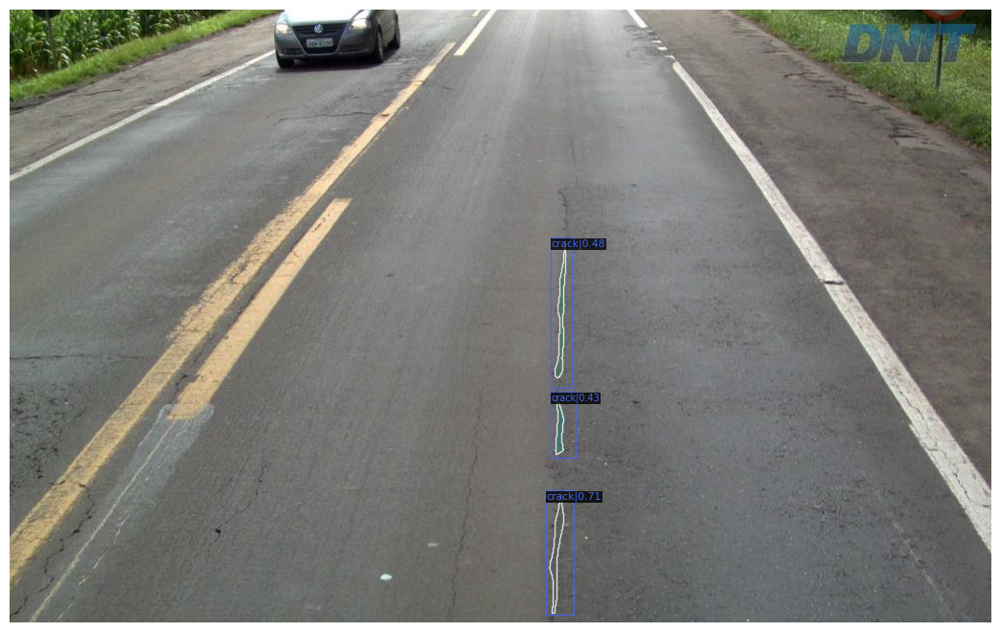

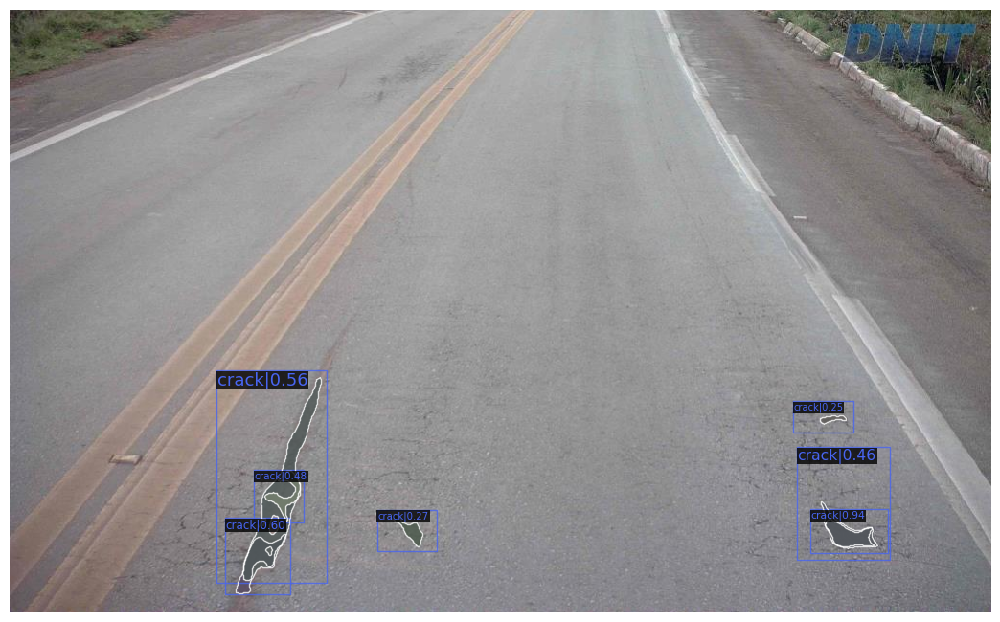

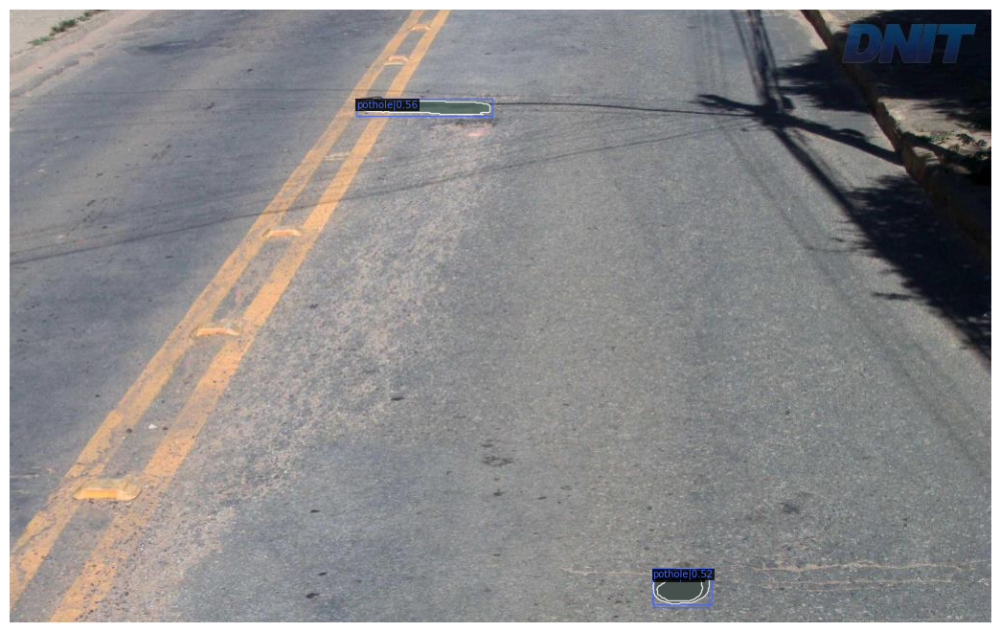

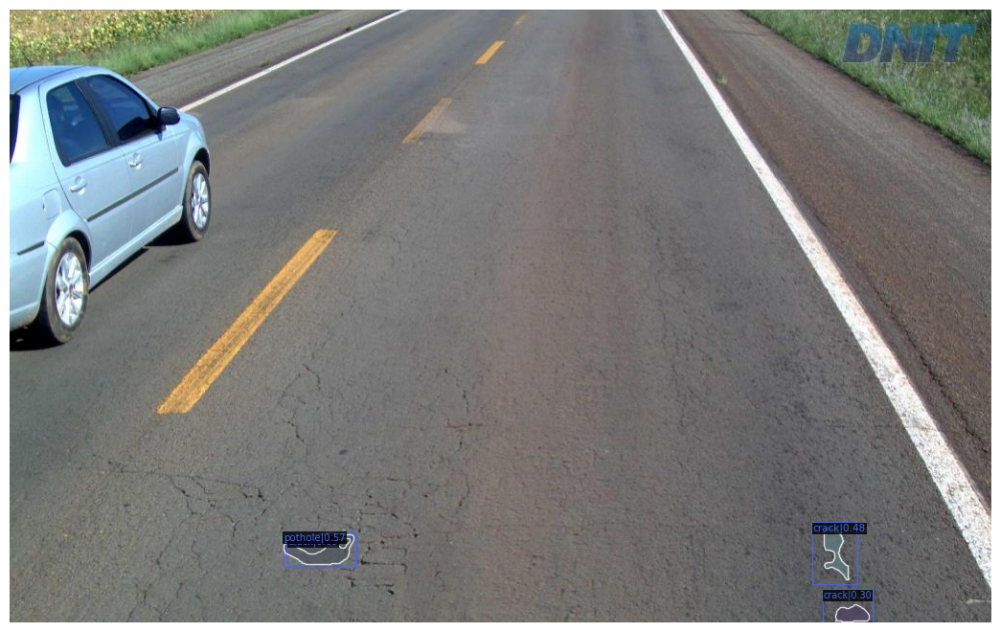

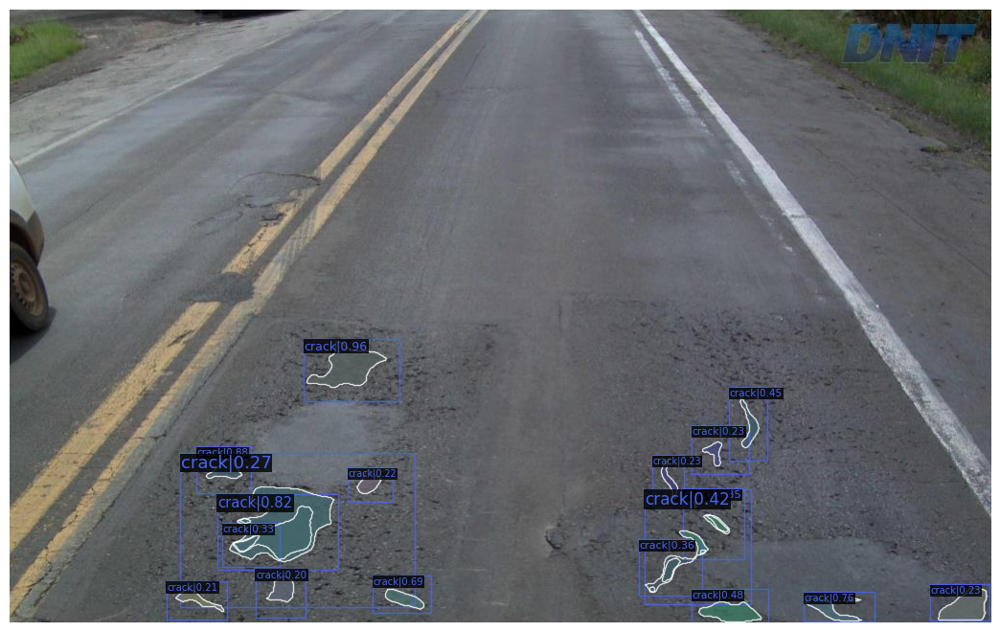

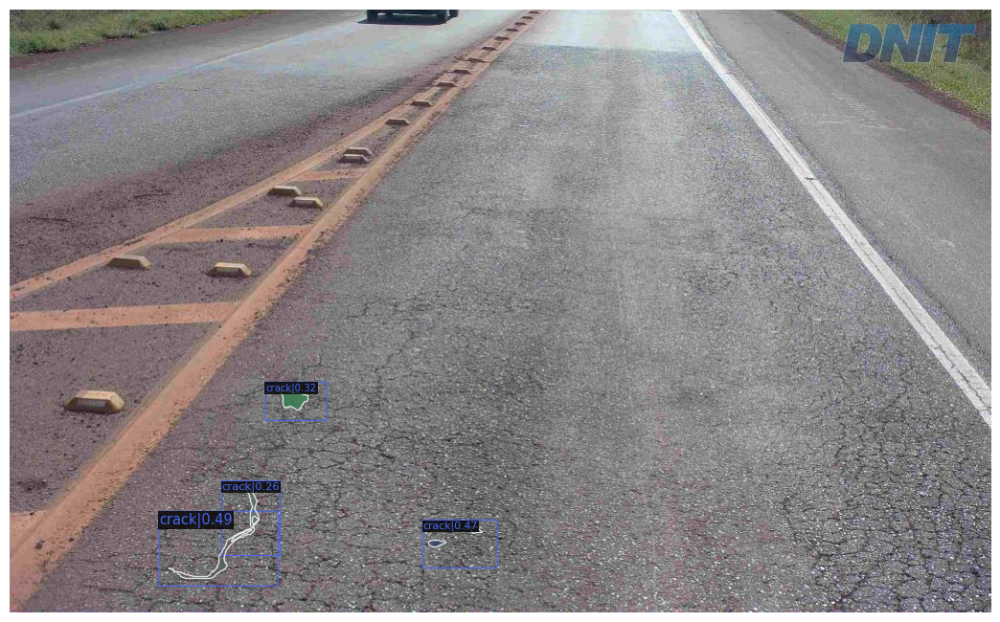

In [56]:

for img in imgs:
    img_path = TEST_DIR + img['file_name']
    result = mmapi.inference_detector(testModel, img_path)
    MaskRCNN.show_result(testModel, img_path, result, score_thr=0.2, thickness=1, mask_color=(90,100,100), show=True)

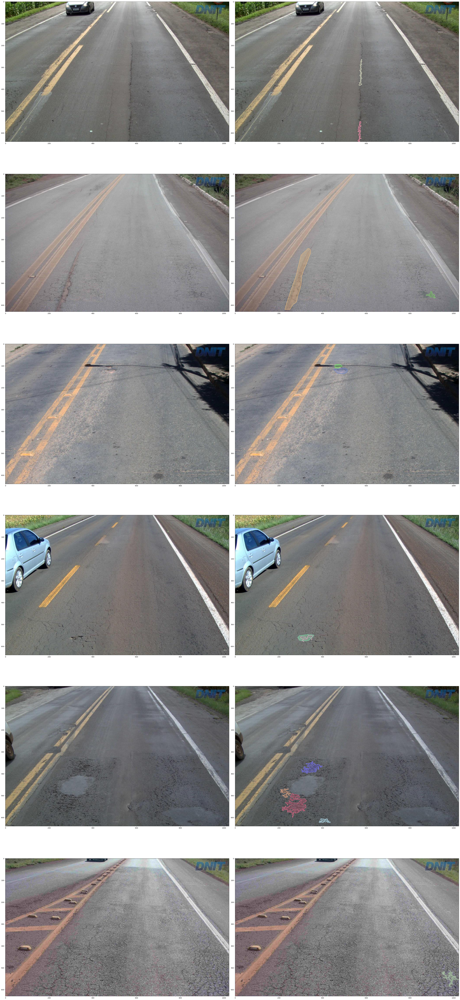

In [51]:
_, axs = plt.subplots(len(imgs),2,figsize=(40,15 * len(imgs)))
for img, ax in zip(imgs, axs):
    I = Image.open(os.path.join(TEST_DIR, img['file_name']))
    annIds = test_coco.getAnnIds(imgIds=[img['id']])
    anns = test_coco.loadAnns(annIds)
    ax[0].imshow(I)
    ax[1].imshow(I)
    plt.sca(ax[1])
    test_coco.showAnns(anns, draw_bbox=False)
plt.tight_layout()
plt.show()

In [4]:
MRCNN_USER_CONFIG_PTH = CONFIGS_DIR + "mask_rcnn_r50_fpn_1x_coco_for_road_damages_5.py"
MRCNN_RESNET50_FPN_RDD_PTH = CONFIGS_DIR + "mask_rcnn_r50_fpn_1x_coco_for_road_damages_5_epoch_25.pth"
testModel = mmapi.init_detector(MRCNN_USER_CONFIG_PTH, MRCNN_RESNET50_FPN_RDD_PTH, cfg_options=dict(resume_from = MRCNN_RESNET50_FPN_RDD_PTH))
testModel.CLASSES = datasets[0].CLASSES

load checkpoint from local path: ./configs/mask_rcnn_r50_fpn_1x_coco_for_road_damages_5_epoch_25.pth


D:\University\RoadDamageDetection\mmdetection\mmdet\apis\inference.py:51: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '


load checkpoint from local path: ./configs/mask_rcnn_r50_fpn_1x_coco_for_road_damages_5_epoch_25.pth


D:\University\RoadDamageDetection\mmdetection\mmdet\apis\inference.py:51: UserWarning: Class names are not saved in the checkpoint's meta data, use COCO classes by default.
  warnings.warn('Class names are not saved in the checkpoint\'s '
D:\University\RoadDamageDetection\mmdetection\mmdet\datasets\utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


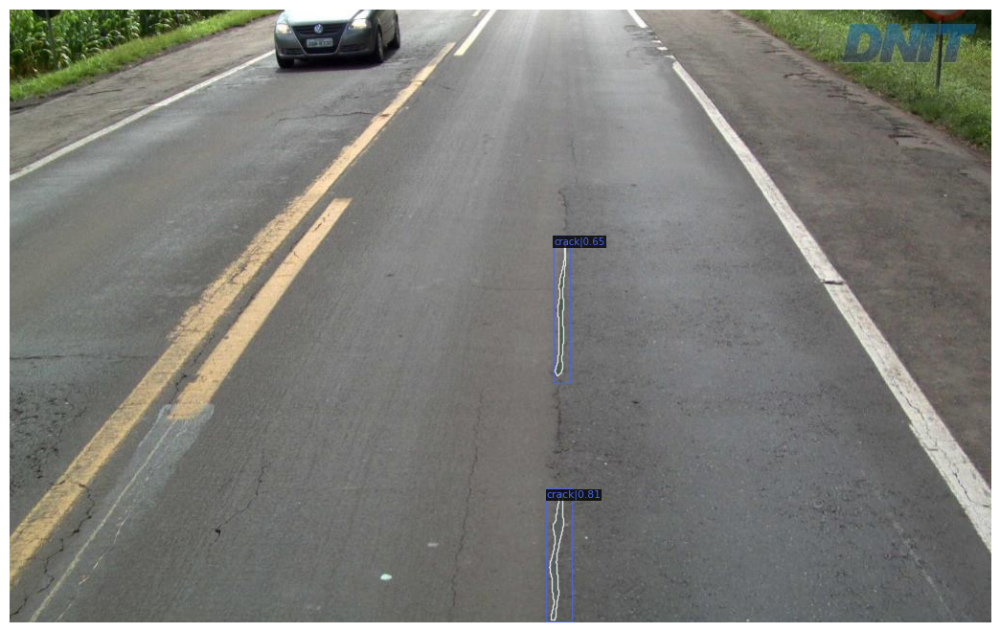

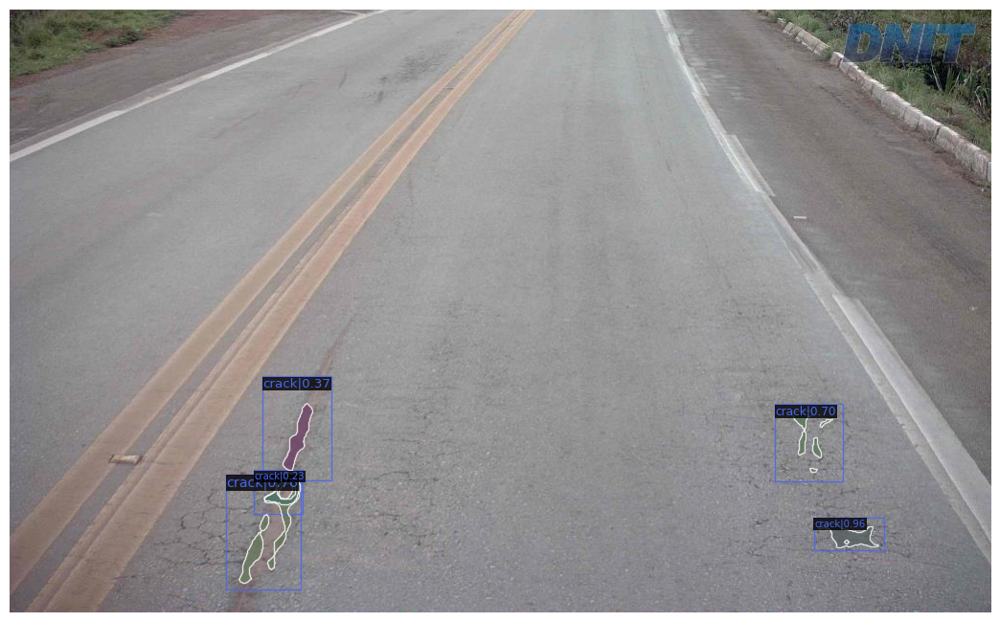

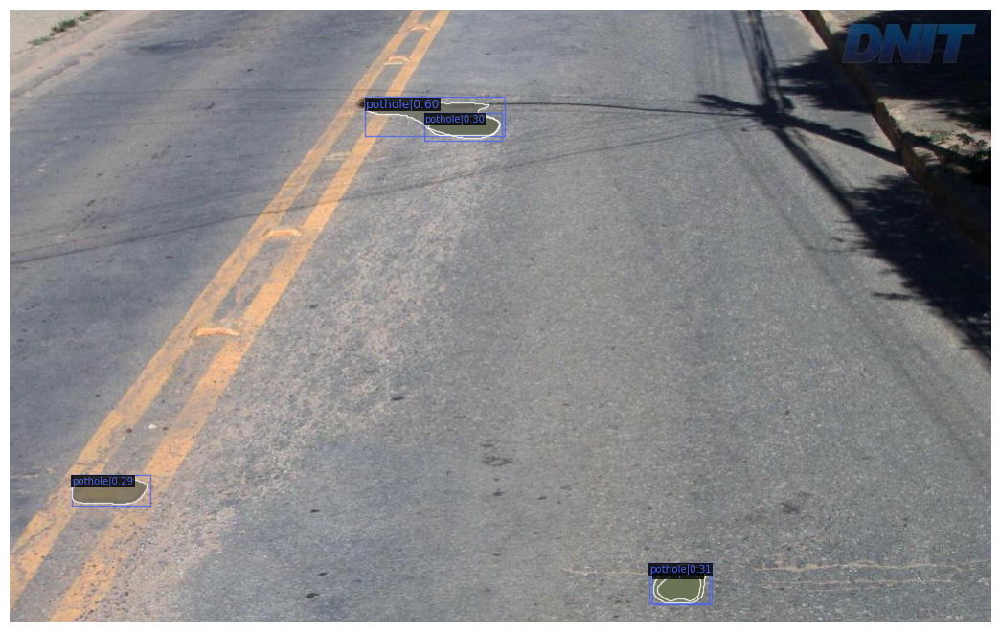

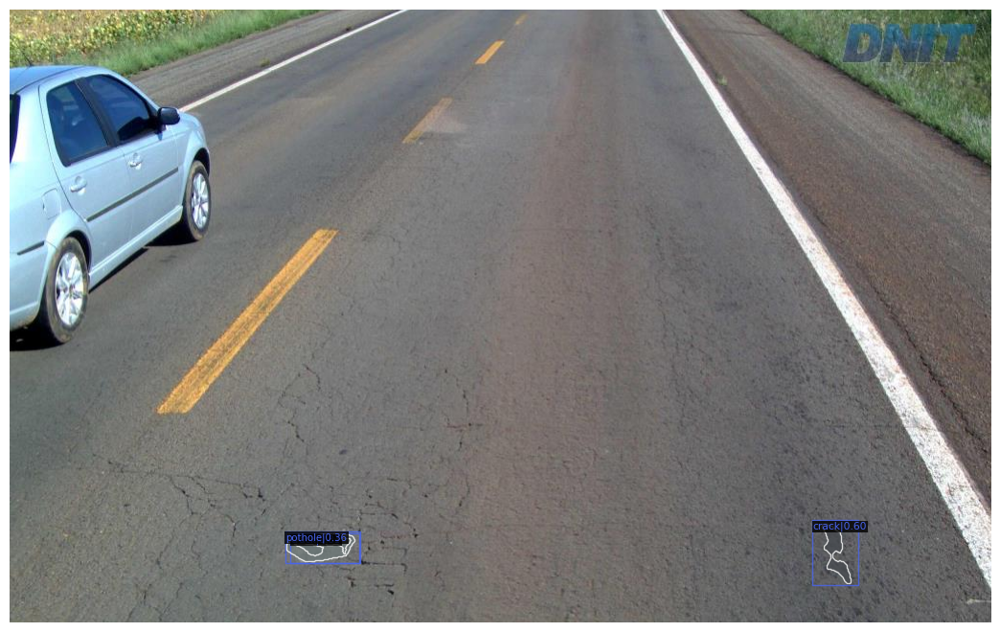

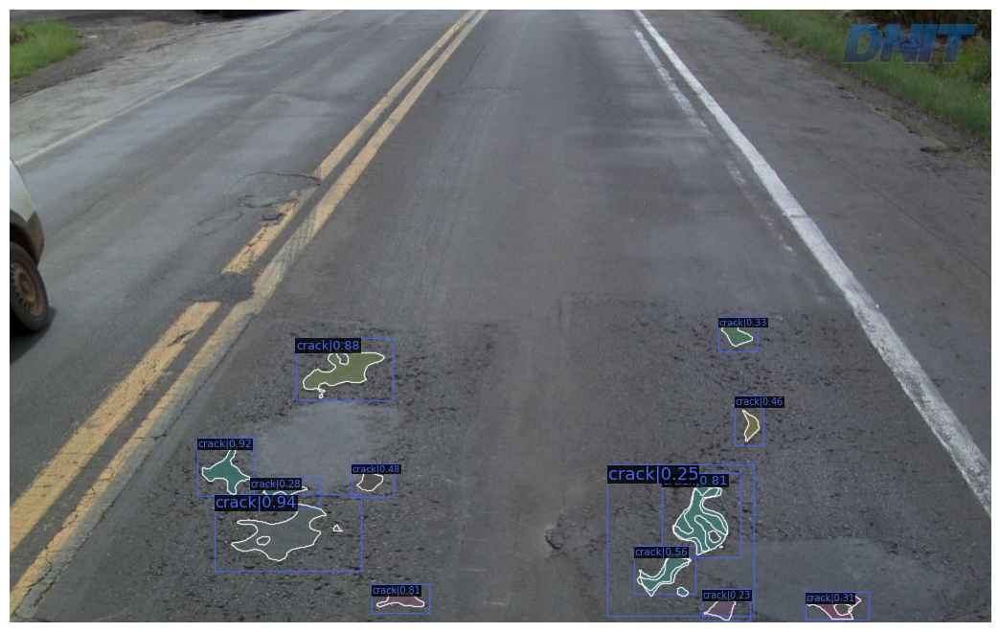

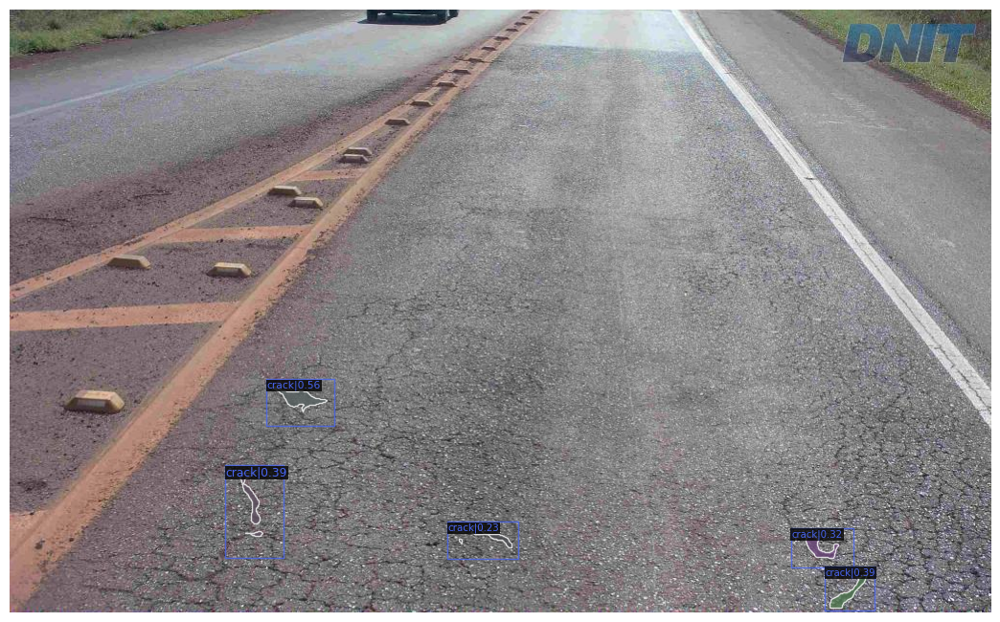

In [53]:
for img in imgs:
    img_path = TEST_DIR + img['file_name']
    result = mmapi.inference_detector(testModel, img_path)
    MaskRCNN.show_result(testModel, img_path, result, score_thr=0.2, thickness=1, mask_color=(90,100,100), show=True)

In [8]:
TEST_VIDEO_PTH = os.path.abspath("D:\\University\\АД\\Кузьмичи\\18 ОП РЗ 18К-01-16 (обратное направление).avi")
cap = cv2.VideoCapture(TEST_VIDEO_PTH)

while True:
    ret, frame = cap.read()
    if ret:
        result = mmapi.inference_detector(testModel, frame)
        # annotated_frame = MaskRCNN.show_result(testModel, frame, result, score_thr=0.2, thickness=1)
        annotated_frame = testModel.show_result(frame, result, score_thr=0.31, thickness=1)
        cv2.imshow("RDD Inference", annotated_frame)
        if cv2.waitKey(25) & 0xFF == ord('q') or ret==False:
            break
    else:
        break
cap.release()
cv2.destroyAllWindows()

D:\University\RoadDamageDetection\mmdetection\mmdet\datasets\utils.py:66: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(
